| Technological Institute of the Philippines | Quezon City - Computer Engineering                                      |
| ------------------------------------------ | ----------------------------------------------------------------------- |
| Course Code:                               | CPE 313                                                                 |
| Code Title:                                | Advanced Machine Learning and Deep Learning                             |
| 1st Semester                               | AY 2023-2024                                                            |
| <hr>                                       | <hr>                                                                    |
| <u>**ACTIVITY NO.**                        | **TITLE**                                                               |
| **Name**                                   | Estacion, Kenneth                                                       |
| **Section**                                | CPE32S8                                                                 |
| **Date Performed**:                        | Feb. 20, 2024                                                           |
| **Date Submitted**:                        | Feb. 22, 2024                                                           |
| **Instructor**:                            | Dr. Jonathan V. Taylar / Engr. Verlyn V. Nojor / Engr. Roman M. Richard |

<hr>


## 1. Objectives


This activity aims to allow students to perform face detection on still images and videos using Haar cascades.


## 2. Intended Learning Outcomes (ILOs)

After this activity, the students should be able to:

- Utilize OpenCV to detect faces in still images and videos.
- Demonstrate the use of Haar-like features for detection of other human features.


## 3. Procedures and Outputs


Contrary to initial assumptions, conducting face detection on a static image and a video stream shares a remarkable similarity. Essentially, the latter is merely a sequential rendition of the former: when detecting faces in videos, it essentially involves applying face detection to every individual frame obtained from the camera feed. Of course, video face detection introduces additional elements like tracking, which aren't relevant to static images. Nevertheless, it's valuable to recognize that the fundamental principles behind both processes remain consistent.


### Performing face detection on still image


The first and most basic way to perform face detection is to load an image and detect faces in it. To make the result visually meaningful, we will draw rectangles around faces on the original image.


**Before implementing the code below**, check the contents of the `cv2.CascadeClassifier()` function. Provide an explanation of the function, its parameters before running the code below.


In [3]:
# Make sure that for this activity, you have downloaded the
# file indicated below from the resource linked in the instructional materials
# in the module.
from google.colab.patches import cv2_imshow
import cv2
picPath = 'breakingbad.jpg'
haarPath = 'haarcascade_frontalface_default.xml'
def faceDetect(picPath):
  face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + haarPath)

  img = cv2.imread(picPath)
  gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  faces = face_cascade.detectMultiScale(gray, 1.3, 5)

  for (x, y, w, h) in faces:
    img = cv2.rectangle(img, (x, y), (x+w, y+h), (255,0,0), 2)

  cv2_imshow(img)

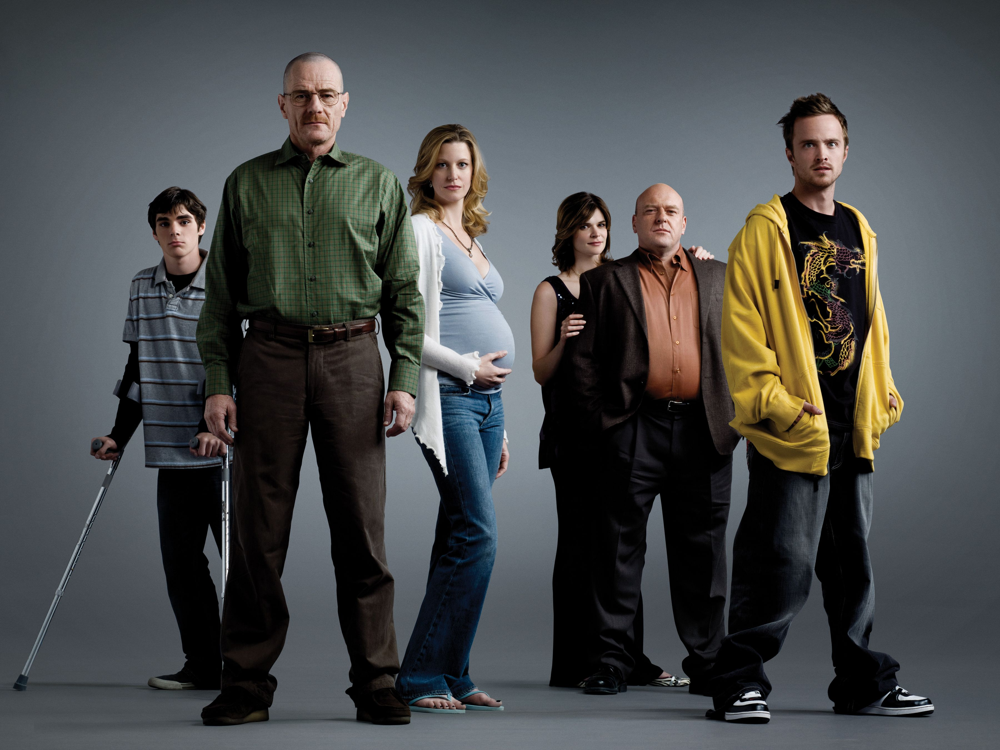

In [4]:
img = cv2.imread(picPath)
cv2_imshow(img)

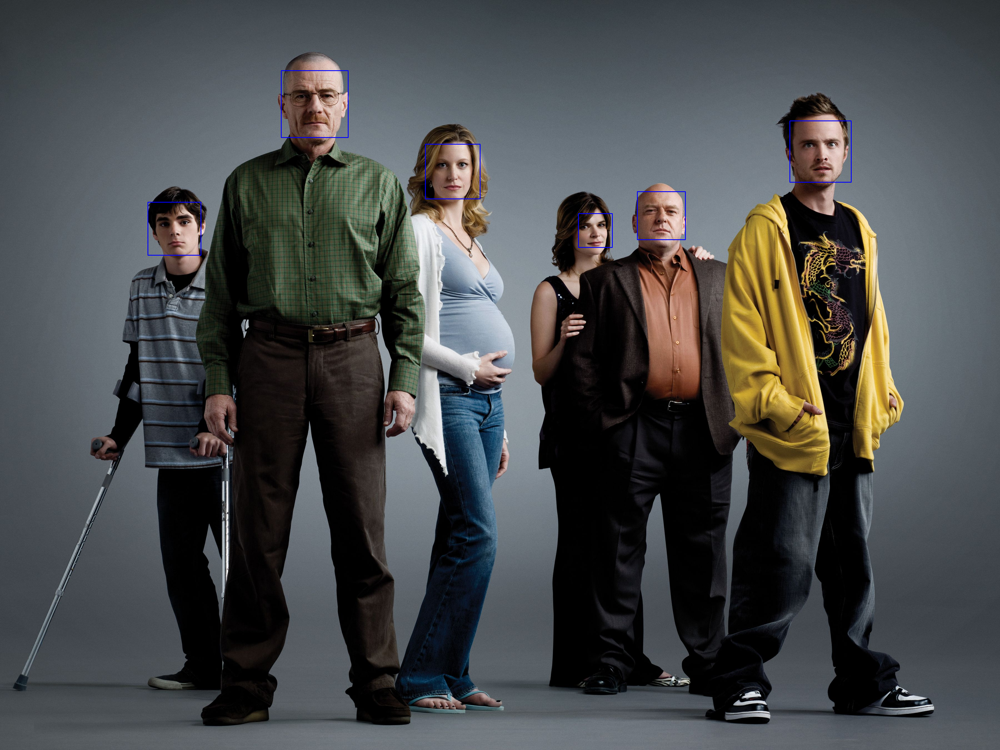

In [5]:
faceDetect(picPath)

**Analysis**:

- Based on your earlier analysis, where do you think the face detection works in the line of code above?
- Provide an analysis of the parameters of the `detectMultiScale` method.
- Change the color of the border of the detected faces to red.
- Are you able to make the borders thicker? Demonstrate.


### Performing face detection on video


**Step 1**: Create a file called face_detection.py and include the following codes.


In [ ]:
import cv2

**Step 2:** After this, we declare a method, `detect()`, which will perform face detection.


In [ ]:
def detect():
  face_cascade = cv2.CascadeClassifier('haarcascade_frontalface_default.xml')
  eye_cascade = cv2.CascadeClassifier('haarcascade_eye.xml')
  camera = cv2.VideoCapture(0)

**Step 3:** The first thing we need to do inside the detect() method is to load the Haar cascade files so that OpenCV can operate face detection. As we copied
the cascade files in the local `cascades/` folder, we can use a relative path. Then, we open a VideoCapture object (the camera feed). The VideoCapture constructor takes a parameter, which indicates the camera to be used; zero indicates the first camera available.


In [ ]:
  while (True):
    ret, frame = camera.read()
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

**Step 4:** Next up, we capture a frame. The read() method returns two values: a Boolean indicating the success of the frame read operation, and the frame
itself. We capture the frame, and then we convert it to grayscale. This is a necessary operation, because face detection in OpenCV happens in the grayscale color space:


In [ ]:
faces = face_cascade.detectMultiScale(gray, 1.3, 5)

**Step 5:** Much like the single still image example, we call detectMultiScale on the grayscale version of the frame.


In [ ]:
  for (x,y,w,h) in faces:
    img = cv2.rectangle(frame,(x,y),(x+w,y+h),(255,0,0),2)
    roi_gray = gray[y:y+h, x:x+w]
    eyes = eye_cascade.detectMultiScale(roi_gray, 1.03,
    5, 0, (40,40))

**Step 6:** Here we have a further step compared to the still image example: we create a region of interest corresponding to the face rectangle, and within this rectangle, we operate "eye detection". This makes sense as you wouldn't want to go looking for eyes outside a face (well, for human beings at least!).


In [ ]:
  for (ex,ey,ew,eh) in eyes:
    cv2.rectangle(img,(ex,ey),(ex+ew,ey+eh),
    (0,255,0),2)

**Step 7:** Again, we loop through the resulting eye tuples and draw green rectangles around them.


In [ ]:

    cv2.imshow("camera", frame)
    if cv2.waitKey(1000 / 12) & 0xff == ord("q"):
      break

  camera.release()
  cv2.destroyAllWindows()

if __name__ == "__main__":
detect()

**Provide the following**:

- Screenshot of the output for the working code once you've put it all together.
- Summary of the steps you've performed along with observations.


In [ ]:
import cv2

def detect():
    face_cascade = cv2.CascadeClassifier('haarcascade_frontalface_default.xml')
    eye_cascade = cv2.CascadeClassifier( 'haarcascade_eye.xml')
    camera = cv2.VideoCapture(0)

    while True:
        ret, frame = camera.read()
        gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        faces = face_cascade.detectMultiScale(gray, 1.3, 5)

        for (x, y, w, h) in faces:
            img = cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 0, 255), 2)
            roi_gray = gray[y:y + h, x:x + w]
            roi_color = img[y:y+h, x:x+w]
            eyes = eye_cascade.detectMultiScale(roi_gray, 1.03, 5, 0, (40, 40))
            for (ex, ey, ew, eh) in eyes:
                cv2.rectangle(roi_color, (ex, ey), (ex + ew, ey + eh), (255, 0, 0), 2)




        cv2.imshow("camera", frame)
        if cv2.waitKey(83) & 0xff == ord("q"):
            break

    camera.release()
    cv2.destroyAllWindows()

if __name__ == "__main__":
    detect()


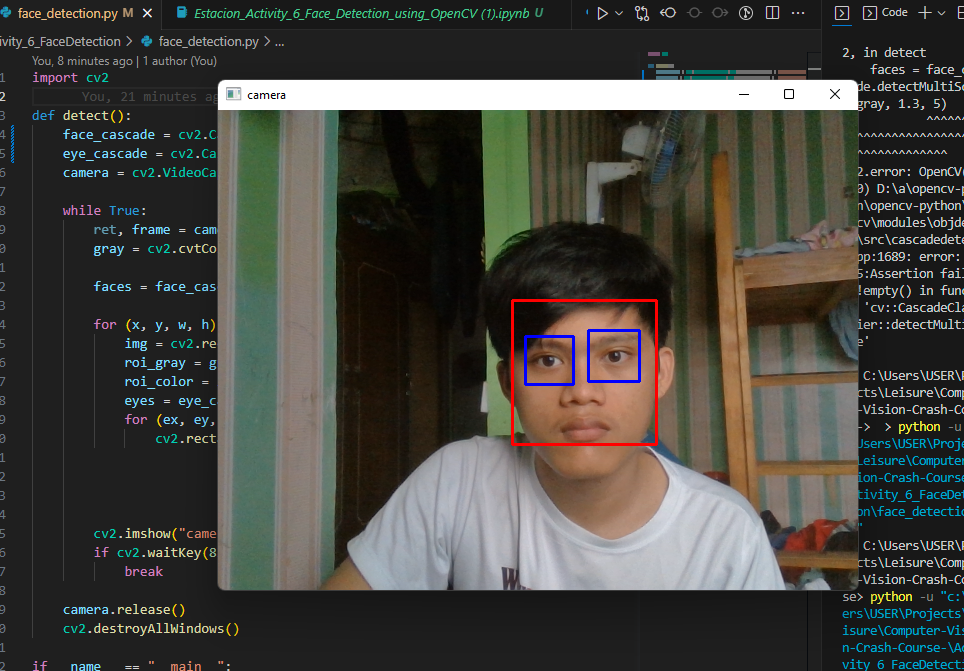

I downloaded the required two xml files for face detection. This was found on github and I attached them to my directory. After modifying the code based on the location of my files, the images and the box for their faces were displayed correctly.

I also created a face_detection python file. It uses my own camera to film myself. Then,  in each video frame, the function detect MultiScale was called to detect the locations of the faces. A box is inserted aroound it.
This is then sent to a loop to get to get the region of the eyes (ROeyes). A box was inserted in each eye.

Upon executing, my face was immediately detected as seen by the hollowed red rectangle. My two eyes were also detected as seen with the blu e rectangles. They also move as I move to the camera. Although they fail to detect at about 45 degree of me tilting anchored to the camera.

## 4. Supplementary Activity


In your Cameo project, include real-time face detection using Haar cascade. Show screenshots of the working demonstration for this supplementary activity.

Additionally, implement similar steps to detect a smile using Haar cascades.


## 5. Summary, Conclusions and Lessons Learned


<hr/>

**_Proprietary Clause_**

_Property of the Technological Institute of the Philippines (T.I.P.). No part of the materials made and uploaded in this learning management system by T.I.P. may be copied, photographed, printed, reproduced, shared, transmitted, translated, or reduced to any electronic medium or machine-readable form, in whole or in part, without the prior consent of T.I.P._
